In [1]:
%matplotlib inline
from utils import *
from plotting import *
from models import *

## Load data and model

In [2]:
tasks = ['openArena', 'detour', 'doubleTmaze', 'cylinder', 'permanence']

In [3]:
task = tasks[0]

In [4]:
dataset, pose = load_dataset('datasets/'+task, file_format='.npy', load_pose=True, pose_filename='pose.npy')
train_loader = create_dataloader(dataset, batch_size=256, reshuffle_after_epoch=True)

In [5]:
position = pose[:,:2]
orientation = pose[:,2]

In [6]:
model = Conv_AE(n_hidden=1000).to('cuda')

In [7]:
#model.load_state_dict(torch.load('saved_models/{}_sparse-AE_1000hidden.pth'.format(task)))
model.load_state_dict(torch.load('saved_models/AE_ortho.pth'.format(task)))

<All keys matched successfully>

In [8]:
embeddings = get_latent_vectors(dataset, model)

In [9]:
embeddings.shape

(20000, 1000)

## Activation clamping

In [243]:
clamping_value = np.mean(np.max(clean_embeddings(embeddings), axis=0))

In [244]:
clamping_value

0.21702434

In [253]:
features = extract_feature_images(model, clean_embeddings(embeddings), clamping_value=0.217)

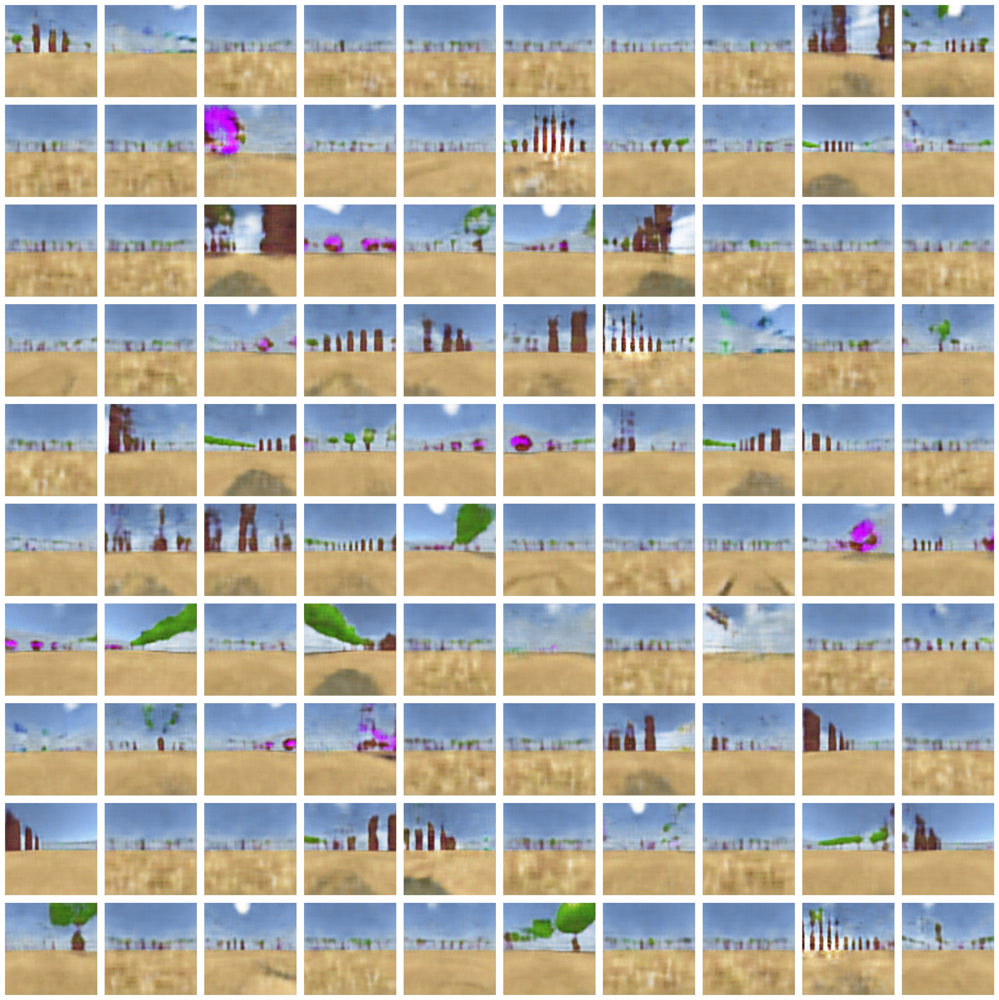

In [254]:
plt.figure(figsize=(20,20), dpi=300)
for i in range(100):
    plt.subplot(10, 10, i+1)
    plt.imshow(features[i], interpolation='bilinear')
    plt.axis('off')
plt.tight_layout()
plt.show()

## Maximum activation samples

In [11]:
embeddings_active = np.where(embeddings<0.8*embeddings.max(axis=0), 0, 1)
#embeddings_active = np.where(embeddings<0.01, 0, 1)

In [12]:
embeddings_active_specific = embeddings_active[:, np.mean(embeddings_active, axis=0)<0.2].T

In [13]:
embeddings_active_specific.shape

(687, 20000)

In [14]:
indxs_embeddings_active_specific = []
for embeddings_ in embeddings_active_specific:
    indxs_embeddings_active_specific.append( np.nonzero(embeddings_) )

In [44]:
embeddings[:,np.any(embeddings, axis=0)].T.shape

(687, 20000)

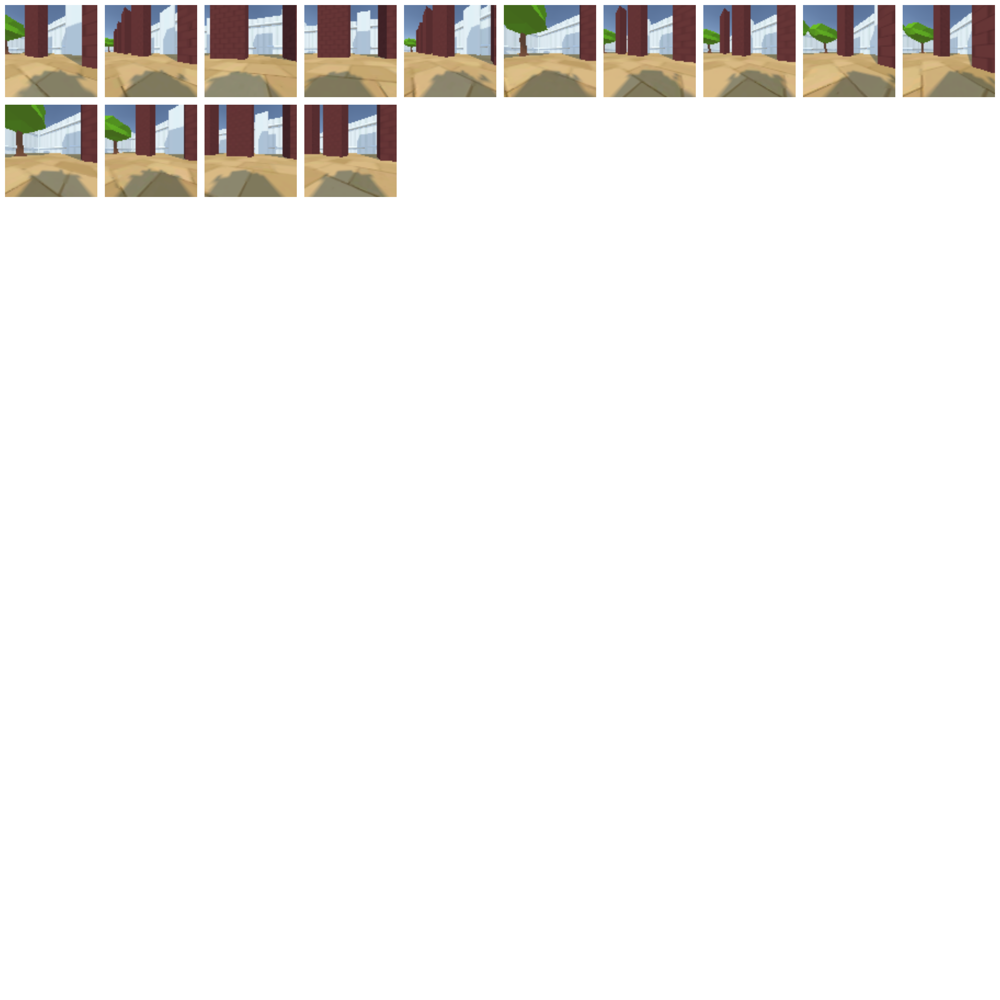

In [251]:
plt.figure(figsize=(20,20), dpi=300)
indx=3
for i in range(100):
    plt.subplot(10, 10, i+1)
    if i < dataset[indxs_embeddings_active_specific[indx]].shape[0]:
        plt.imshow(dataset[indxs_embeddings_active_specific[indx]][i], interpolation='bilinear')
    plt.axis('off')
plt.tight_layout()
plt.show()

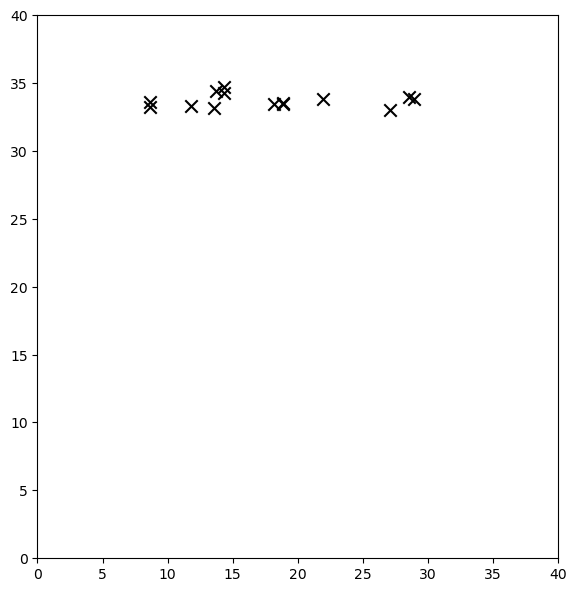

In [252]:
plt.figure(figsize=(4,4))

#plt.imshow(np.sum(all_ratemaps[:-1], axis=0), cmap='hot', origin='lower')
x = position[indxs_embeddings_active_specific[indx],0]
y = position[indxs_embeddings_active_specific[indx],1]
plt.scatter(x, y, color='black', marker='x', s=80)
#plt.axis('off')

plt.tight_layout()
#plt.axis('off')
plt.ylim(0, 40)
plt.xlim(0, 40)
plt.show()

## Activation maximization (gradient ascent in image space)

In [ ]:
opt_act_imgs = find_max_activation_images(model, embeddings, dataset, img_shape=[3, 84, 84], 
                                          init='max_avg', num_epochs=2000, lr=1e-1)

Unit 13/687, Loss: 0.2297:  15%|█████████▏                                                  | 308/2000 [00:03<00:17, 96.38it/s]

In [ ]:
plt.figure(figsize=(20,20), dpi=300)
for i in range(100):
    plt.subplot(10, 10, i+1)
    plt.imshow(opt_act_imgs[i], interpolation='bilinear')
    plt.axis('off')
plt.tight_layout()
plt.show()

## Discretization of input space

In [ ]:
## do 2D t-SNE over image space
## then check whether maximally activating images cluster in 2D space and how much they overlap across neurons
## e.g., different neurons different colors of blobbs in the 2D space.